In [ ]:
# %% Use trained AstroCLIP model to embed entire dataset

from tqdm import tqdm
import torch
from datasets import load_dataset
from pl_bolts.models.self_supervised import Moco_v2
import torch.nn.functional as F
from src.models import OutputExtractor, AstroCLIP, AlternateSpender
from torch.utils.data import DataLoader
from torchvision.transforms import (
    Compose,
    RandomVerticalFlip,
    RandomHorizontalFlip,
    RandomRotation,
    CenterCrop,
    InterpolationMode,
)
import numpy as np
from src.utils import dr2_rgb

import matplotlib.pyplot as plt
import matplotlib.patches as patches

from mpl_toolkits.axes_grid1.inset_locator import inset_axes

from scipy.ndimage import gaussian_filter1d as gf

print("imports done")

PROVABGS_PATH = "C:\datasets_astroclip\BGS_ANY_full.provabgs.sv3.v0.hdf5"

c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\pl_bolts\__init__.py:11: FutureWarning: In the future `np.object` will be defined as the corresponding NumPy scalar.
  if not hasattr(numpy, tp_name):
c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\pl_bolts\__init__.py:11: FutureWarning: In the future `np.bool` will be defined as the corresponding NumPy scalar.
  if not hasattr(numpy, tp_name):
c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\pl_bolts\models\self_supervised\amdim\amdim_module.py:34: UnderReviewWarning: The feature generate_power_seq is currently marked under review. The compatibility with other Lightning projects is not guaranteed and API may change at any time. The API and functionality may change without warning in future releases. More details: https://lightning-bolts.readthedocs.io/en/latest/stability.html
  "lr_options": generate_power_seq(LEARNING_RATE_CIFAR, 11),
c:\Users\Andre\anaconda3\envs\astroclip_2\Lib\site-packages\pl_bolt

imports done


In [ ]:
# %% Load the embeddings from saved files

emb = np.load("data/embeddings-main.npz")
source_images = emb["images"]
im_embeddings = emb["im_embeddings"]
spectra = emb["spectra"]
redshifts = emb["redshifts"]
source_spec = emb["source_spec"]
targetid = emb["targetid"]

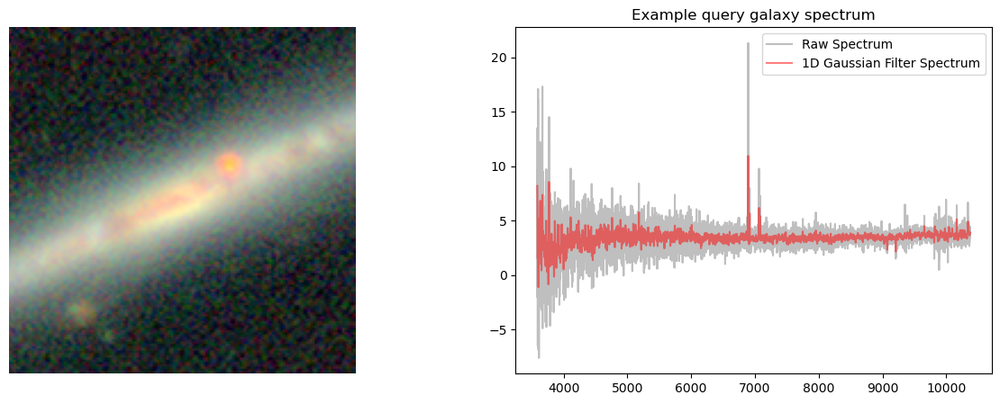

In [ ]:
# %%

l = np.linspace(3586.7408577, 10372.89543574, len(source_spec[0]))
ind_query = 12
plt.figure(figsize=[15, 5])
plt.subplot(1, 2, 1)
plt.imshow(source_images[ind_query])
plt.axis("off")
plt.subplot(1, 2, 2)
plt.plot(l, source_spec[ind_query], color="grey", alpha=0.5, label="Raw Spectrum")
plt.plot(
    l,
    gf(source_spec[ind_query][:, 0], 2),
    color="red",
    alpha=0.5,
    label="1D Gaussian Filter Spectrum",
)
plt.title("Example query galaxy spectrum")
plt.legend()
# normalise the embedding by diving by the L2 norm
# image_features = im_embeddings / np.linalg.norm(im_embeddings, axis=-1, keepdims=True)
# spectra_features = spectra / np.linalg.norm(spectra, axis=-1, keepdims=True)

image_features = F.normalize(torch.tensor(im_embeddings), p=2, dim=-1).numpy()
spectra_features = F.normalize(torch.tensor(spectra), p=2, dim=-1).numpy()

# compute the similarity between the query spectrum and all the image embeddings (i.e. dot product)
cross_sp = spectra_features[ind_query] @ image_features.T  # vector of similarity scores

Query with spectrum-> image cross similarity


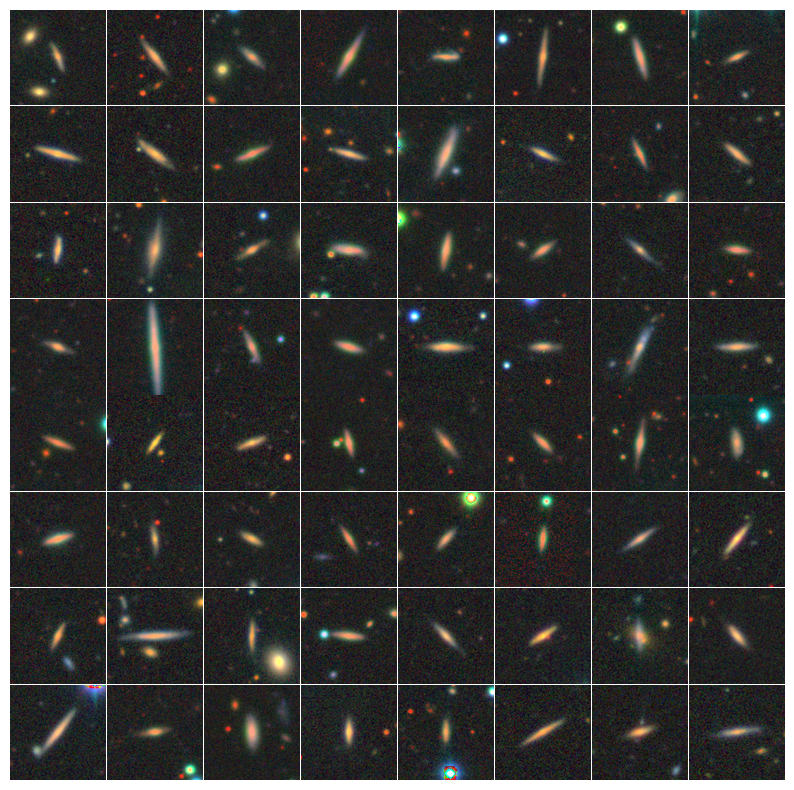

In [ ]:
# %% Spectrum query -> top 64 image retrieval

# Sort the indices of the 'similarity' array in descending order
print("Query with spectrum-> image cross similarity")
ind_sorted = np.argsort(cross_sp)[::-1]
plt.figure(figsize=[10, 10])
for i in range(8):
    for j in range(8):
        plt.subplot(8, 8, i * 8 + j + 1)
        plt.imshow(source_images[ind_sorted[i * 8 + j]])
        plt.axis("off")
plt.subplots_adjust(wspace=0.01, hspace=0.01)

<>:88: SyntaxWarning: invalid escape sequence '\-'
<>:88: SyntaxWarning: invalid escape sequence '\-'
<ipython-input-5-24d4e301c6d7>:88: SyntaxWarning: invalid escape sequence '\-'
  plt.title("Cross Image-Spectra\-Similarity")


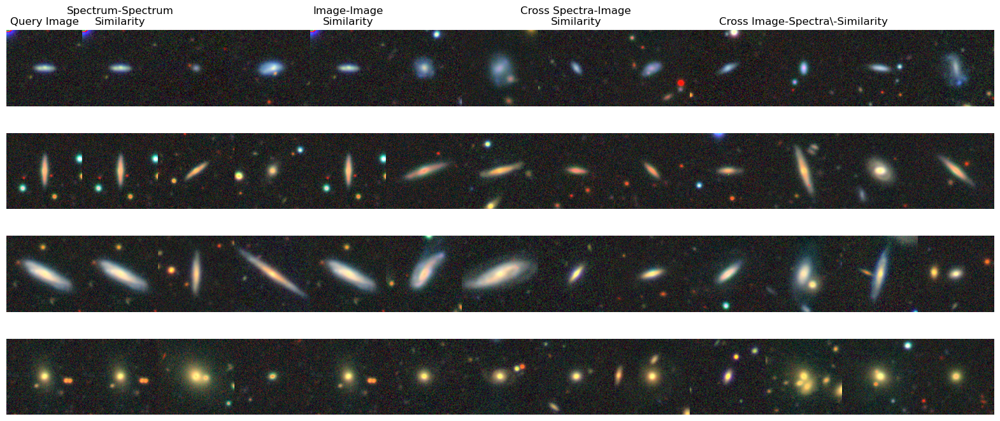

In [ ]:
# %%

ind_queries = [4, 300, 669, 23]
# good:14,500
results = {
    "images_sp_sp": [],  # Spectral query, spectral retrieval (sp_sim)
    "images_im_im": [],  # Image query, image retrieval (im_sim)
    "images_sp_im": [],  # Spectral query, image retrieval (cross_sp_sim)
    "images_im_sp": [],  # Image query, spectral retrieval (cross_im_sim)
    "spectra_sp_sp": [],  # Spectral query, spectral retrieval (sp_sim)
    "spectra_im_im": [],  # Image query, spectral retrieval (im_sim)
    "spectra_sp_im": [],  # Spectral query, image retrieval (cross_sp_sim)
    "spectra_im_sp": [],  # Image query, spectral retrieval (cross_im_sim)
}

for ind_query in ind_queries:
    sp_sim = spectra_features[ind_query] @ spectra_features.T
    im_sim = image_features[ind_query] @ image_features.T
    cross_im_sim = image_features[ind_query] @ spectra_features.T
    cross_sp_sim = spectra_features[ind_query] @ image_features.T

    results["images_sp_sp"].append(
        [source_images[i] for i in np.argsort(sp_sim)[::-1][:8]]
    )
    results["images_im_im"].append(
        [source_images[i] for i in np.argsort(im_sim)[::-1][:8]]
    )
    results["images_sp_im"].append(
        [source_images[i] for i in np.argsort(cross_sp_sim)[::-1][:8]]
    )
    results["images_im_sp"].append(
        [source_images[i] for i in np.argsort(cross_im_sim)[::-1][:8]]
    )

    results["spectra_sp_sp"].append(
        [source_spec[i] for i in np.argsort(sp_sim)[::-1][:8]]
    )
    results["spectra_im_im"].append(
        [source_spec[i] for i in np.argsort(im_sim)[::-1][:8]]
    )
    results["spectra_sp_im"].append(
        [source_spec[i] for i in np.argsort(cross_sp_sim)[::-1][:8]]
    )
    results["spectra_im_sp"].append(
        [source_spec[i] for i in np.argsort(cross_im_sim)[::-1][:8]]
    )

# The results dictionary now holds the top similar images and spectra for each query index.

plt.figure(figsize=[20, 10])
for n, i in enumerate(ind_queries):
    # Plot query image
    plt.subplot(5, 13, n * 13 + 1)
    plt.imshow(source_images[i])
    plt.axis("off")
    if n == 0:
        plt.title("Query Image")

    # Image similarity
    for j in range(3):
        plt.subplot(5, 13, n * 13 + j + 1 + 1)
        plt.imshow(results["images_sp_sp"][n][j])
        plt.axis("off")
        if n == 0 and j == 0:
            plt.title("Spectrum-Spectrum\nSimilarity")

    # Spectra similarity
    for j in range(3):
        plt.subplot(5, 13, n * 13 + j + 1 + 3 + 1)
        plt.imshow(results["images_im_im"][n][j])
        plt.axis("off")
        if n == 0 and j == 0:
            plt.title("Image-Image\nSimilarity")

    # Cross image similarity (spectral query, image retrieval)
    for j in range(3):
        plt.subplot(5, 13, n * 13 + j + 1 + 6 + 1)
        plt.imshow(results["images_sp_im"][n][j])
        plt.axis("off")
        if n == 0 and j == 0:
            plt.title("Cross Spectra-Image\nSimilarity")

    # Cross spectrum similarity (image query, spectral retrieval)
    for j in range(3):
        plt.subplot(5, 13, n * 13 + j + 1 + 9 + 1)
        plt.imshow(results["images_im_sp"][n][j])
        plt.axis("off")
        if n == 0 and j == 0:
            plt.title("Cross Image-Spectra\-Similarity")

plt.subplots_adjust(wspace=0.0, hspace=0.3)
plt.savefig("figures/retrievals_together.png", bbox_inches="tight", pad_inches=0)
plt.show()

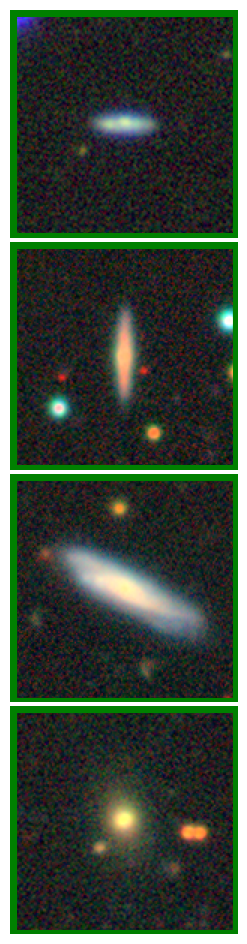

In [ ]:
# %% Plot each one separately

fig_size = (9, 12)
horizontal_space = -0.4  # No horizontal space between images in a row
vertical_space = 0.02  # Vertical space between rows


def create_similarity_plot(results_key, title):
    plt.figure(figsize=fig_size)
    for n in range(len(ind_queries)):
        images = results[results_key][n]
        for j in range(3):
            index = n * 3 + j + 1
            ax = plt.subplot(4, 3, index)
            ax.imshow(images[j])
            ax.axis("off")
    plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust rect if necessary for title
    plt.subplots_adjust(wspace=horizontal_space, hspace=vertical_space)
    # plt.savefig(f"figures/{results_key}.png", bbox_inches="tight", dpi=300)
    plt.show()


def show_query_images():
    plt.figure(figsize=(3, 12))
    for n, i in enumerate(ind_queries):
        ax = plt.subplot(4, 1, n + 1)
        ax.imshow(source_images[i])
        ax.axis("off")
        # Adding a colored border
        rect = patches.Rectangle(
            (0, 0),
            source_images[i].shape[1],
            source_images[i].shape[0],
            linewidth=8,
            edgecolor="green",
            facecolor="none",
        )
        ax.add_patch(rect)
    plt.subplots_adjust(wspace=0, hspace=vertical_space)  # Match vertical spacing
    # plt.savefig("figures/query_images.png", bbox_inches="tight", dpi=300)
    plt.show()


show_query_images()

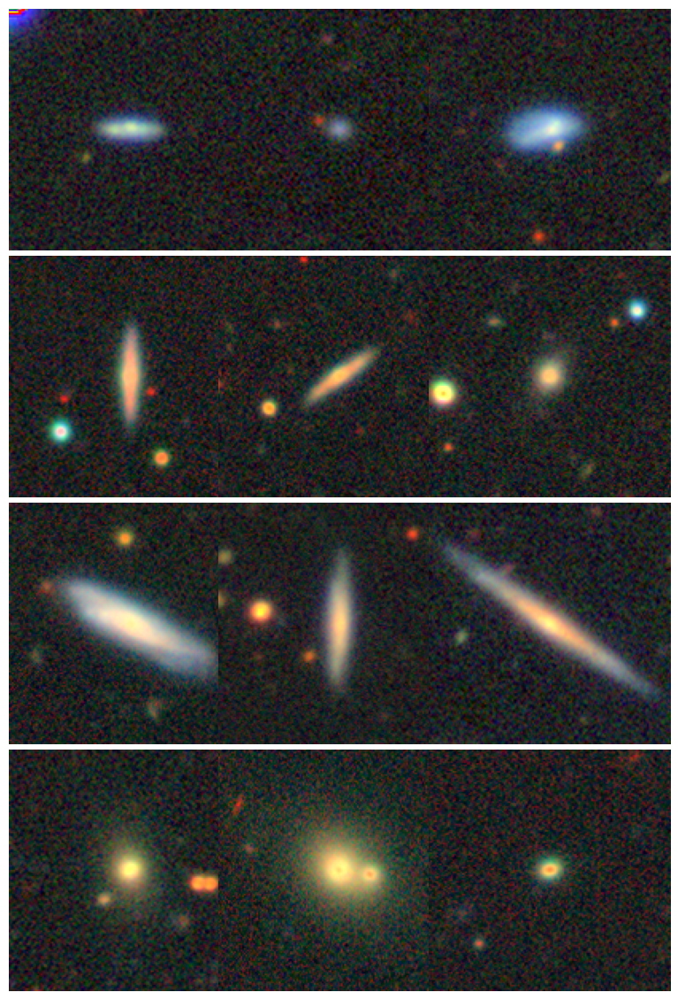

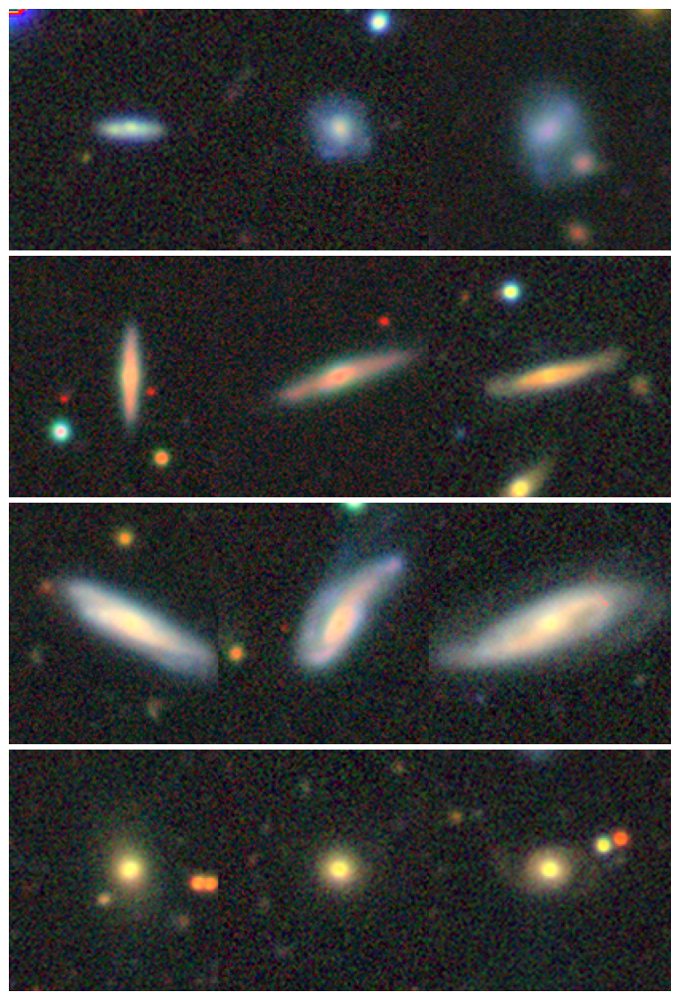

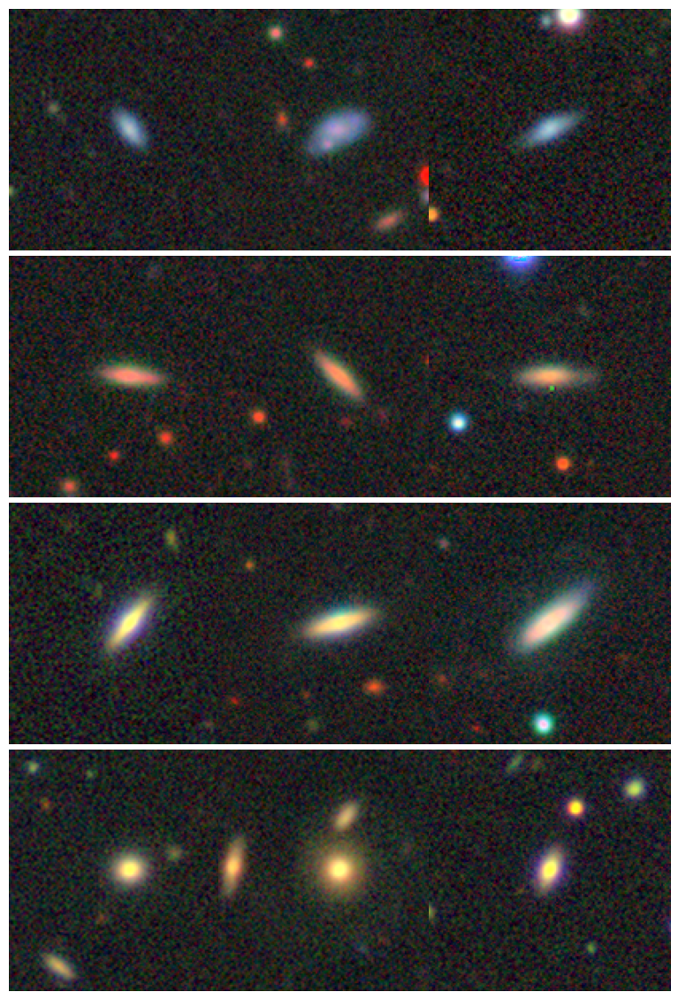

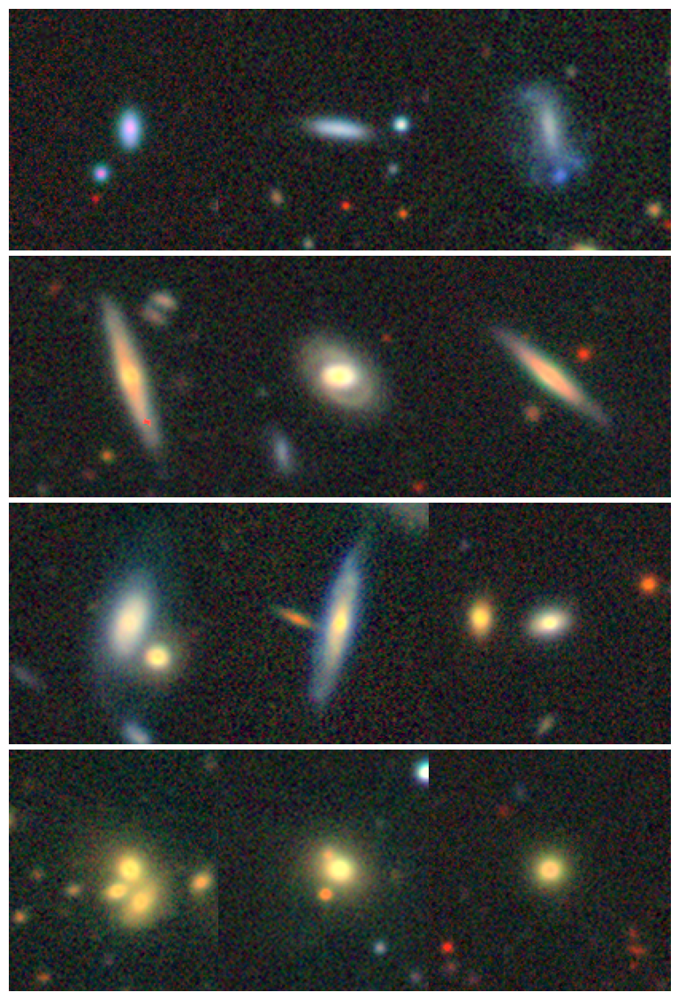

In [ ]:
# %%

create_similarity_plot("images_sp_sp", "Spectrum-Spectrum Similarity")
create_similarity_plot("images_im_im", "Image-Image Similarity")
create_similarity_plot("images_sp_im", "Cross Spectrum-Image Similarity")
create_similarity_plot("images_im_sp", "Cross Image-Spectrum Similarity")

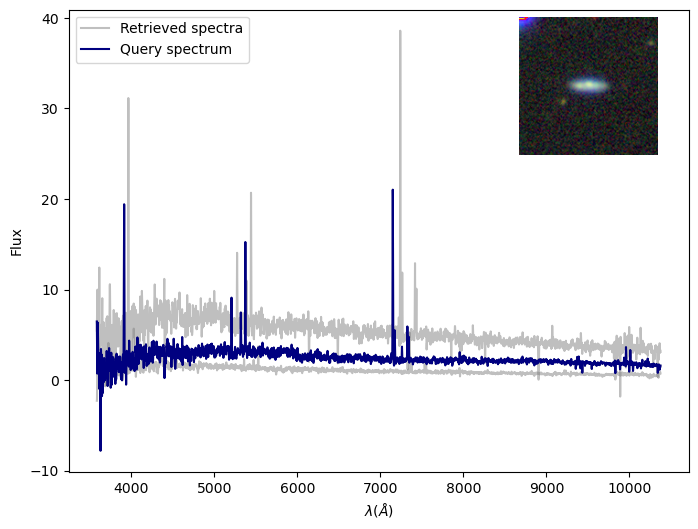

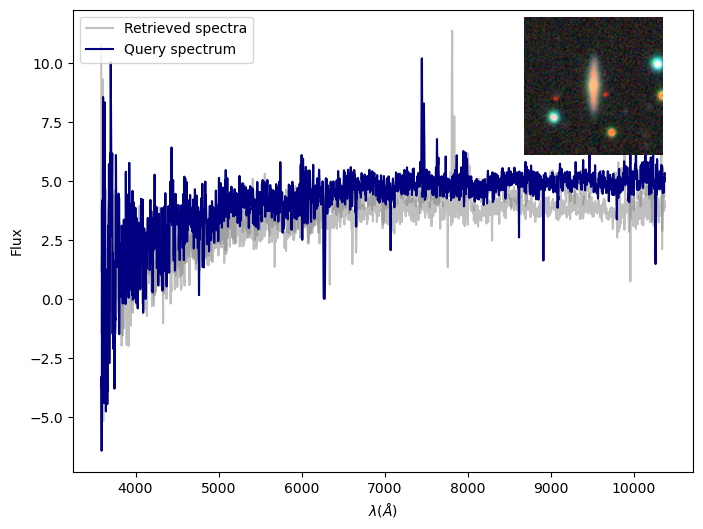

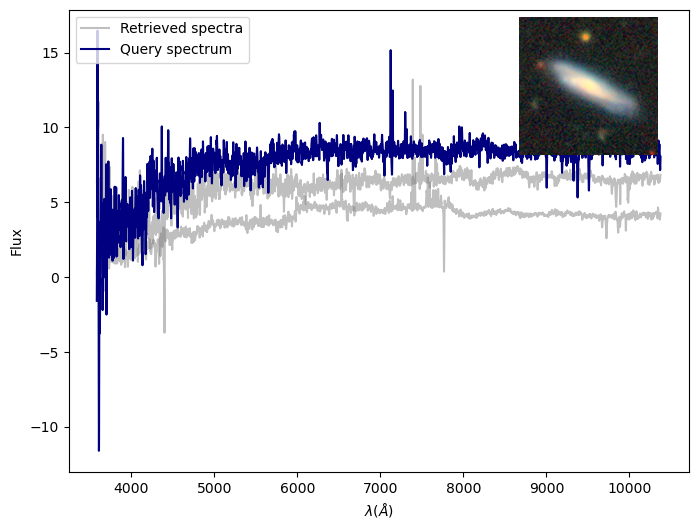

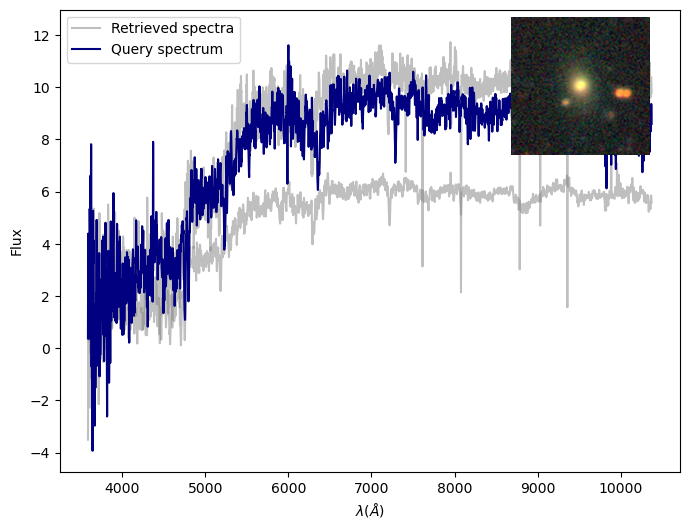

In [ ]:
# %% Plot each one separately for the figures


def plot_spectra_with_image(
    ind_queries,
    results,
    results_key,
    title,
    l,
    source_images,
    image_location="lower right",
):
    for n, i in enumerate(ind_queries):
        query_sp = source_spec[i]
        query_img = source_images[
            i
        ]  # Assuming source_images is the list/array of images corresponding to each spectrum

        plt.figure(figsize=[8, 6])
        ax_main = plt.gca()  # Get current axis
        # plt.title(title)
        # plt.ylim(-0, 20)
        for j in range(3):
            # Apply Gaussian filter to each retrieved spectrum's first column
            filtered_spectrum = gf(results[results_key][n][j][:, 0], 2)
            plt.plot(
                l,
                filtered_spectrum,
                color="grey",
                alpha=0.5,
                label="Retrieved spectra" if j == 0 else None,
            )
        # Apply Gaussian filter to the query spectrum's first column
        filtered_query_sp = gf(query_sp[:, 0], 2)
        plt.plot(l, filtered_query_sp, color="navy", alpha=1, label="Query spectrum")
        plt.legend(loc="upper left")
        plt.xlabel(r"$\lambda (\AA)$")
        plt.ylabel("Flux")

        # Create an inset image at the top right corner of the plot
        ax_inset = inset_axes(ax_main, width="30%", height="30%", loc=image_location)
        ax_inset.imshow(query_img)
        ax_inset.axis("off")  # Turn off axis for inset
        plt.show()


# Example usage:
plot_spectra_with_image(
    ind_queries,
    results,
    "spectra_sp_sp",
    "Spectral query, spectral retrieval (sp_sp)",
    l,
    source_images,
    "upper right",
)

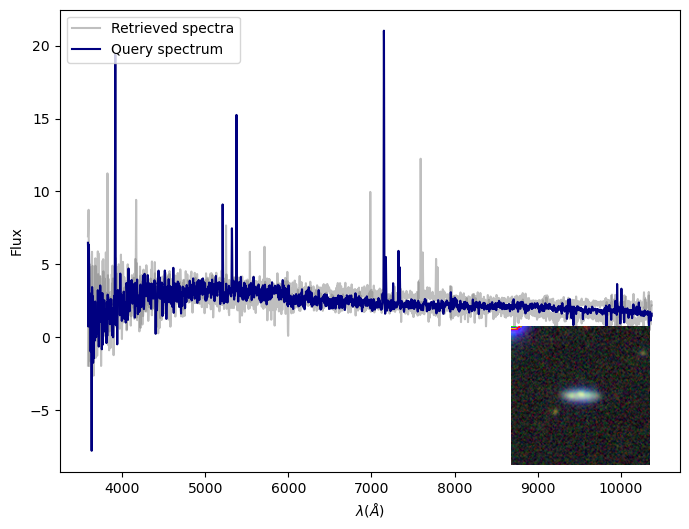

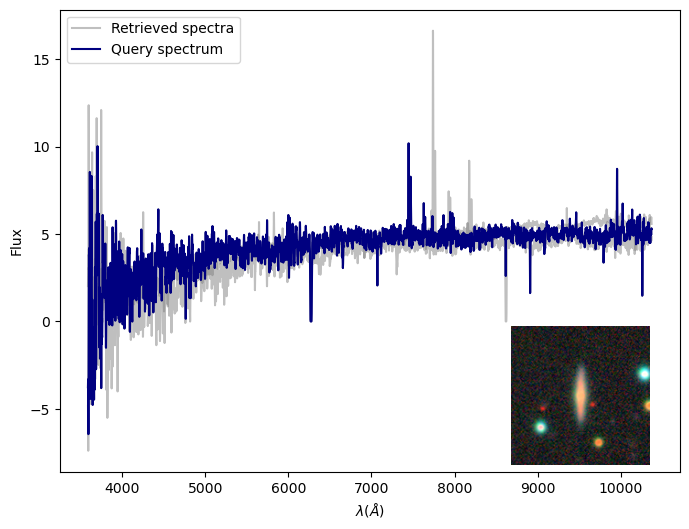

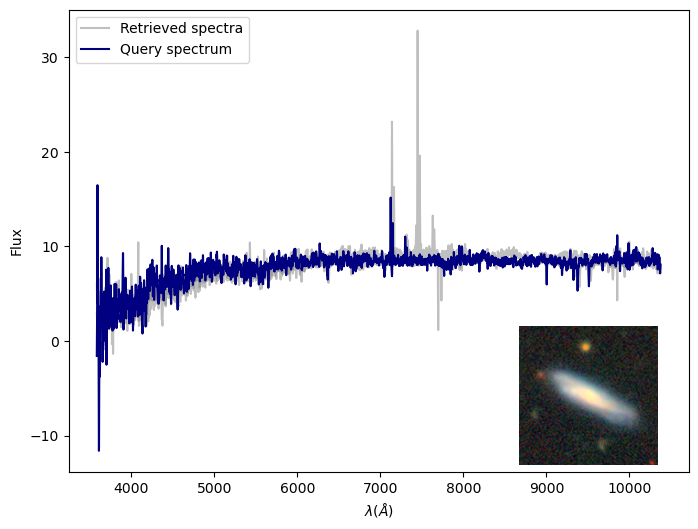

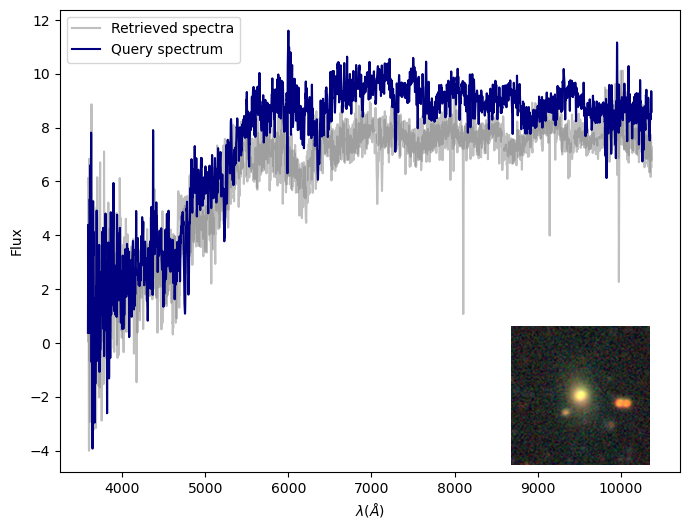

In [ ]:
# %%

plot_spectra_with_image(
    ind_queries,
    results,
    "spectra_im_im",
    "Image query, image retrieval (im_im)",
    l,
    source_images,
)

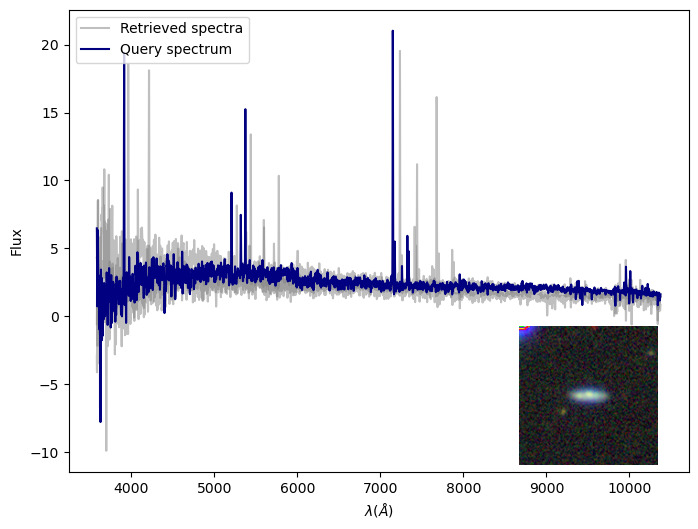

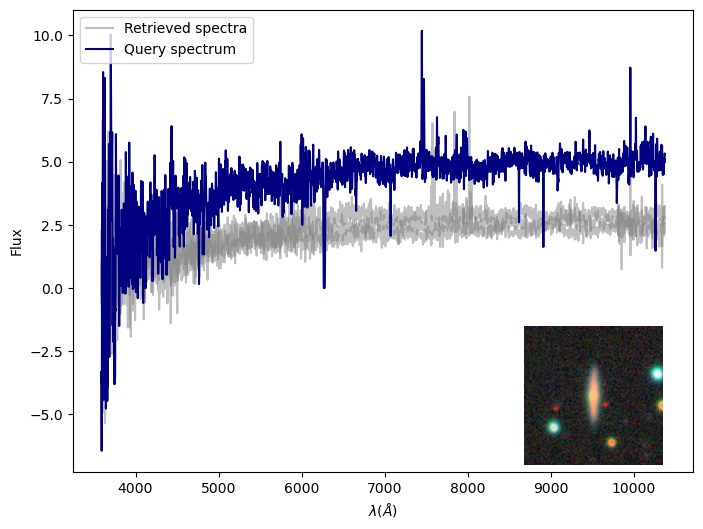

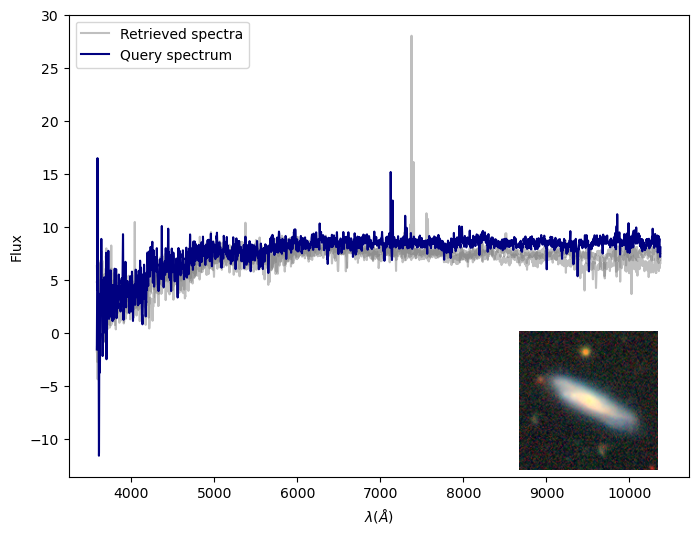

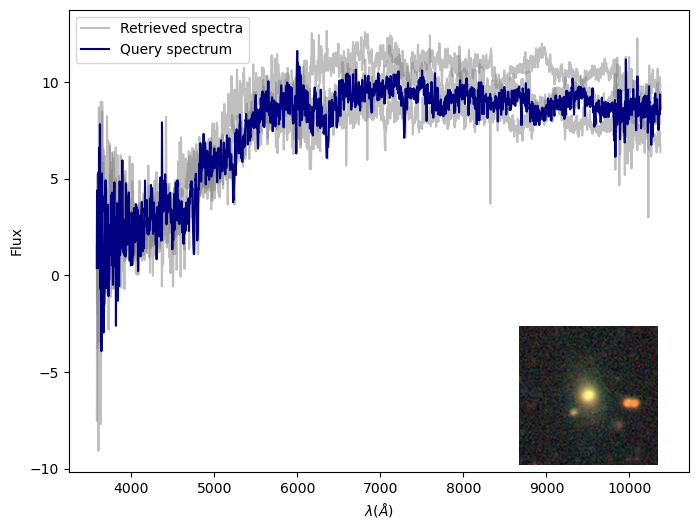

In [ ]:
# %%

plot_spectra_with_image(
    ind_queries,
    results,
    "spectra_sp_im",
    "Spectral query, image retrieval (sp_im)",
    l,
    source_images,
)

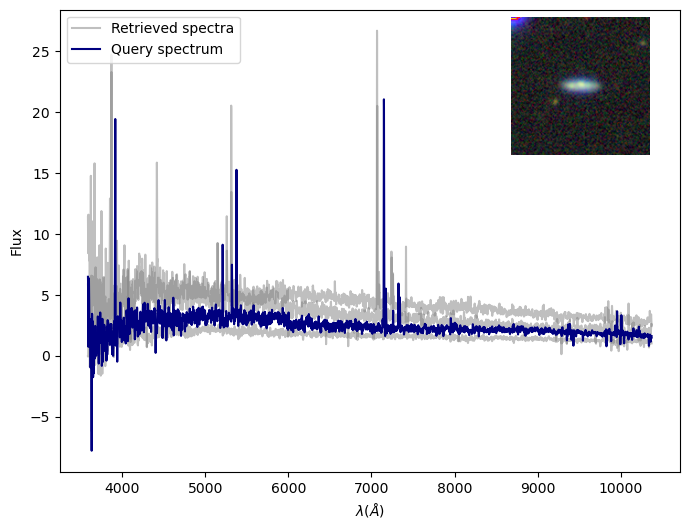

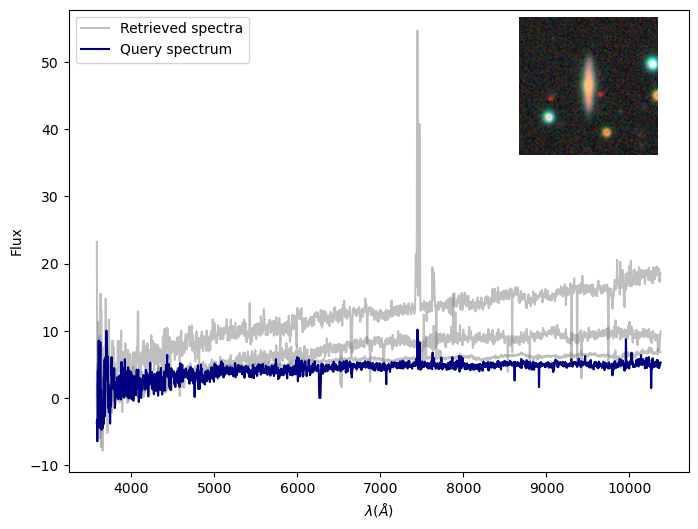

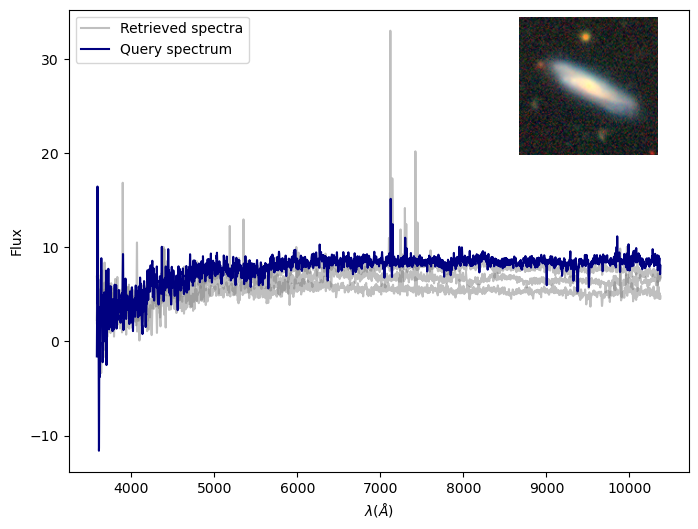

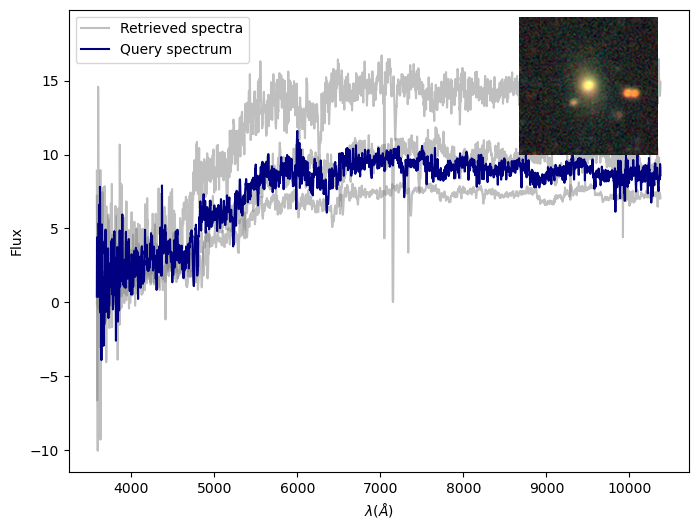

In [ ]:
# %%

plot_spectra_with_image(
    ind_queries,
    results,
    "spectra_im_sp",
    "Image query, spectral retrieval (im_sp)",
    l,
    source_images,
    "upper right",
)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


array([[[255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.],
        ...,
        [255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.]],

       [[255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.],
        ...,
        [255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.]],

       [[255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.],
        ...,
        [255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.]],

       ...,

       [[255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.],
        ...,
        [255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.]],

       [[255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.],
        ...,
        [255., 255., 255.],
        [255., 255., 255.],
        [255., 255., 255.]],

       [[255., 255., 255.],
        [255., 255., 255.],
        [255., 2

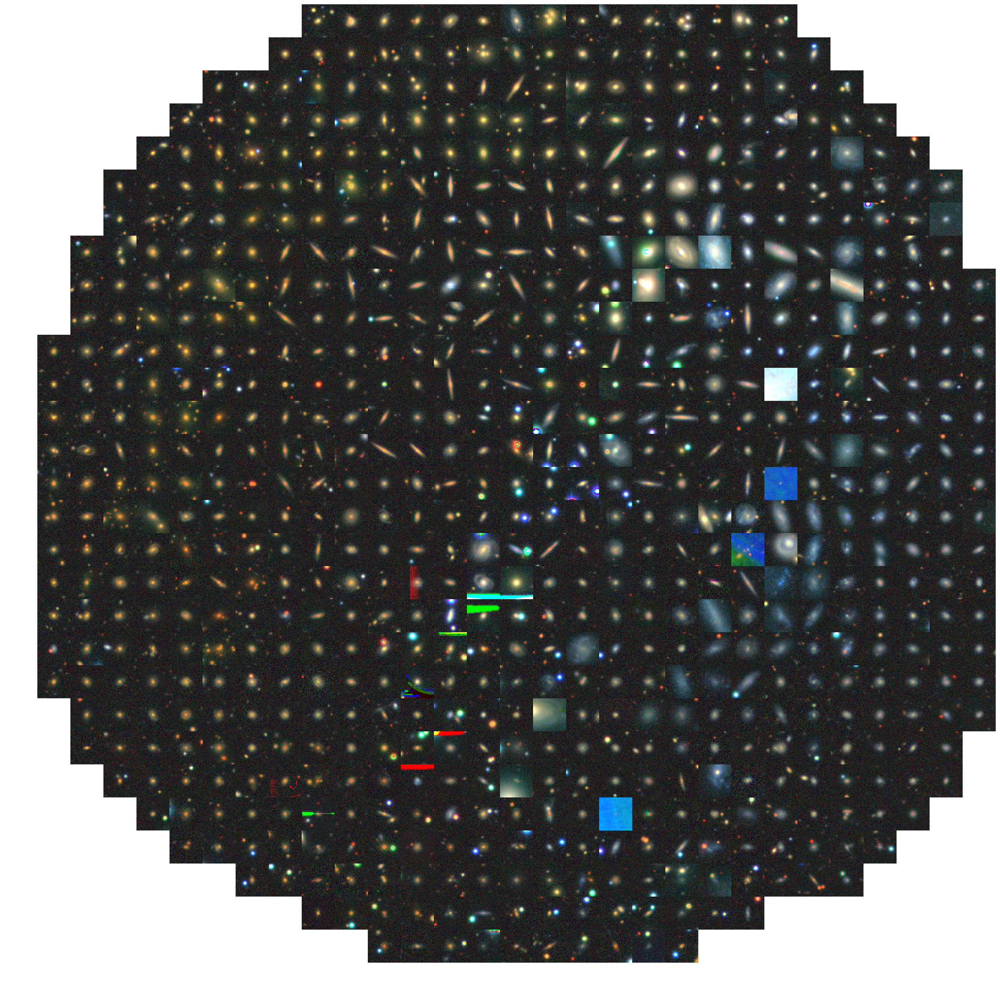

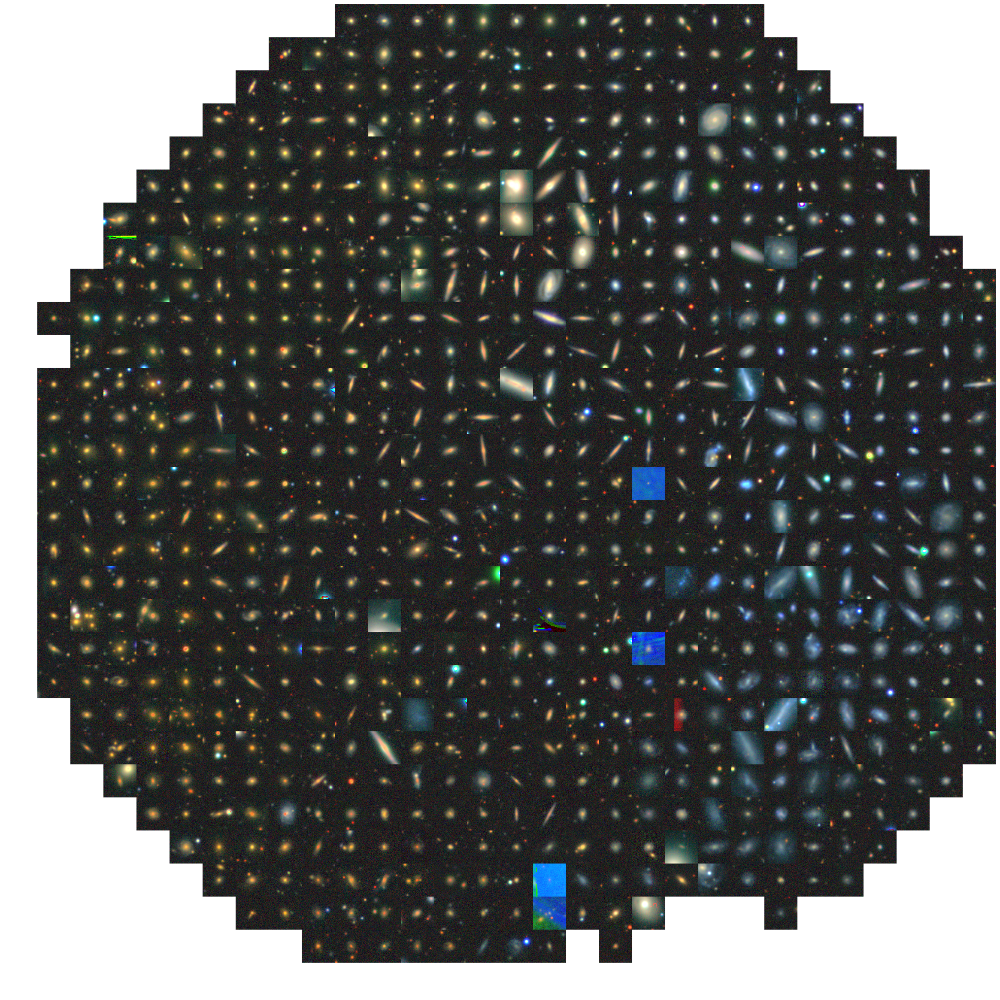

In [ ]:
# %% visualise the embeddings

from sklearn.decomposition import PCA
from src.utils import scatter_plot_as_images

im_pca = PCA(n_components=4).fit_transform(image_features)
sp_pca = PCA(n_components=4).fit_transform(spectra_features)
scatter_plot_as_images(im_pca, source_images, nx=30, ny=30)
scatter_plot_as_images(sp_pca, source_images, nx=30, ny=30)

In [ ]:
# %% Zero shot redshift prediction

import warnings

warnings.filterwarnings("ignore", category=FutureWarning, module="seaborn")
from sklearn.neighbors import KNeighborsRegressor
import seaborn as sns
from sklearn.metrics import r2_score

In [ ]:
# %% Stellar mass zero shot prediction

from astropy.table import Table, join

provabgs = Table.read(PROVABGS_PATH)

# join the provabgs table using the targetid
embedding_table = Table(
    {
        "targetid": targetid,
        "image_embedding": im_embeddings,
        "spectrum_embedding": spectra,
    }
)
provabgs = join(provabgs, embedding_table, keys_left="TARGETID", keys_right="targetid")

# remove invalid values (spurious entries)
provabgs = provabgs[
    (provabgs["PROVABGS_LOGMSTAR_BF"] > 0)
    * (provabgs["MAG_G"] > 0)
    * (provabgs["MAG_R"] > 0)
    * (provabgs["MAG_Z"] > 0)
]


# set random seed
np.random.seed(25101999)
# randomise the order
provabgs = provabgs[np.random.permutation(len(provabgs))]

<>:4: SyntaxWarning: invalid escape sequence '\d'
<>:4: SyntaxWarning: invalid escape sequence '\d'
<ipython-input-21-f334fcebbffd>:4: SyntaxWarning: invalid escape sequence '\d'
  provabgs = Table.read("C:\datasets_astroclip\BGS_ANY_full.provabgs.sv3.v0.hdf5")


In [ ]:
# %%

print("Number of galaxies in the provabgs table:", len(provabgs))

Number of galaxies in the provabgs table: 21051


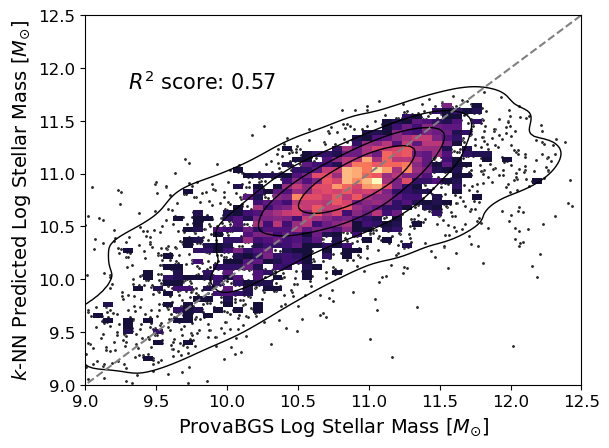

In [ ]:
# %% Stellar mass zero shot prediction from image embeddings

split = 5000

neigh = KNeighborsRegressor(weights="distance", n_neighbors=16)
neigh.fit(
    provabgs["image_embedding"][:-split], provabgs["PROVABGS_LOGMSTAR_BF"][:-split]
)
preds = neigh.predict(provabgs["image_embedding"][-split:])
# plt.figure(figsize=(5, 3.5))
sns.scatterplot(x=provabgs["PROVABGS_LOGMSTAR_BF"][-split:], y=preds, s=5, color=".15")
sns.histplot(
    x=np.clip(provabgs["PROVABGS_LOGMSTAR_BF"][-split:], 8, 12.5),
    y=np.clip(preds, 8, 12.5),
    bins=64,
    pthresh=0.1,
    cmap="magma",
)
sns.kdeplot(
    x=provabgs["PROVABGS_LOGMSTAR_BF"][-split:],
    y=preds,
    levels=5,
    color="black",
    linewidths=1,
)
# Labels and limits with increased font sizes
plt.xlabel(r"ProvaBGS Log Stellar Mass $[M_{\odot}]$", fontsize=14)
plt.ylabel(r"$k$-NN Predicted Log Stellar Mass $[M_{\odot}]$", fontsize=14)
plt.plot([8, 15], [8, 15], color="grey", linestyle="--")
plt.xlim(9, 12.5)
plt.ylim(9, 12.5)

# Increase font size for tick labels
plt.tick_params(axis="both", which="major", labelsize=12)

# Adding text with a larger font size
plt.text(
    9.3,
    11.8,
    "$R^2$ score: %0.2f" % (r2_score(provabgs["PROVABGS_LOGMSTAR_BF"][-split:], preds)),
    fontsize=15,  # Increased font size for the added text
)
# plt.savefig("figures/zeroshot_stellarmass_image.png", bbox_inches="tight", dpi=400)
plt.show()

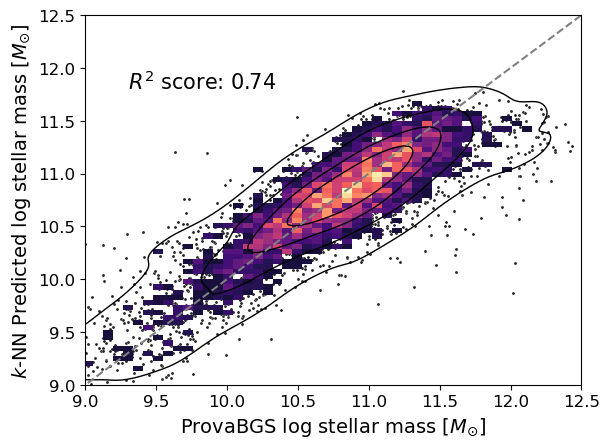

In [ ]:
# %% Stellar mass zero shot prediction from spectra

split = 5000

neigh = KNeighborsRegressor(weights="distance", n_neighbors=16)
neigh.fit(
    provabgs["spectrum_embedding"][:-split], provabgs["PROVABGS_LOGMSTAR_BF"][:-split]
)
preds = neigh.predict(provabgs["spectrum_embedding"][-split:])

sns.scatterplot(x=provabgs["PROVABGS_LOGMSTAR_BF"][-split:], y=preds, s=5, color=".15")
sns.histplot(
    x=np.clip(provabgs["PROVABGS_LOGMSTAR_BF"][-split:], 8, 12.5),
    y=np.clip(preds, 8, 15),
    bins=64,
    pthresh=0.1,
    cmap="magma",
)
sns.kdeplot(
    x=provabgs["PROVABGS_LOGMSTAR_BF"][-split:],
    y=preds,
    levels=5,
    color="black",
    linewidths=1,
)
plt.xlabel(r"ProvaBGS log stellar mass $[M_{\odot}]$", fontsize=14)
plt.ylabel(r"$k$-NN Predicted log stellar mass $[M_{\odot}]$", fontsize=14)
# plt.title("Stellar mass pred with spectrum embeddings")
plt.plot([8, 15], [8, 15], color="grey", linestyle="--")
plt.xlim(9, 12.5)
plt.ylim(9, 12.5)

plt.tick_params(axis="both", which="major", labelsize=12)


plt.text(
    9.3,
    11.8,
    "$R^2$ score: %0.2f" % (r2_score(provabgs["PROVABGS_LOGMSTAR_BF"][-split:], preds)),
    fontsize=15,
)
# plt.savefig("figures/zeroshot_stellarmass_spectrum.png", bbox_inches="tight", dpi=400)
plt.show()

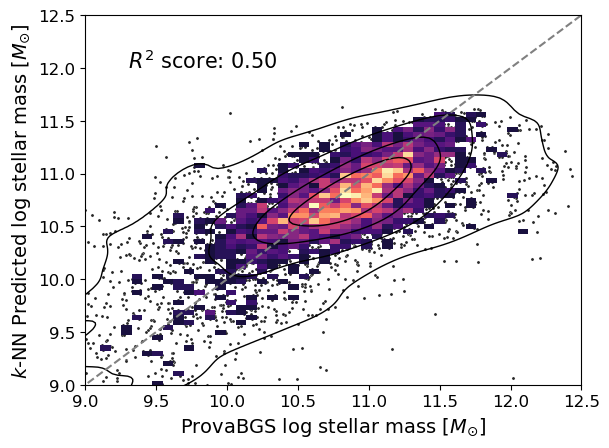

In [ ]:
# %% Cross-modal KNN for stellar mass prediction

split = 5000
neigh = KNeighborsRegressor(weights="distance", n_neighbors=16)
neigh.fit(
    provabgs["spectrum_embedding"][:-split], provabgs["PROVABGS_LOGMSTAR_BF"][:-split]
)
preds = neigh.predict(provabgs["image_embedding"][-split:])
sns.scatterplot(x=provabgs["PROVABGS_LOGMSTAR_BF"][-split:], y=preds, s=5, color=".15")
sns.histplot(
    x=np.clip(provabgs["PROVABGS_LOGMSTAR_BF"][-split:], 8, 15),
    y=np.clip(preds, 8, 15),
    bins=64,
    pthresh=0.1,
    cmap="magma",
)
sns.kdeplot(
    x=provabgs["PROVABGS_LOGMSTAR_BF"][-split:],
    y=preds,
    levels=5,
    color="black",
    linewidths=1,
)
plt.xlabel(r"ProvaBGS log stellar mass $[M_{\odot}]$", fontsize=14)
plt.ylabel(r"$k$-NN Predicted log stellar mass $[M_{\odot}]$", fontsize=14)
# plt.title("Stellar mass pred cross-modal (spectrum regression, prediction with image)")
plt.plot([8, 15], [8, 15], color="grey", linestyle="--")
plt.xlim(9, 12.5)
plt.ylim(9, 12.5)
plt.text(
    9.3,
    12,
    "$R^2$ score: %0.2f" % (r2_score(provabgs["PROVABGS_LOGMSTAR_BF"][-split:], preds)),
    fontsize=15,
)

plt.tick_params(axis="both", which="major", labelsize=12)

# plt.savefig("figures/zeroshot_stellarmass_crossmodal.png", bbox_inches="tight", dpi=400)
plt.show()

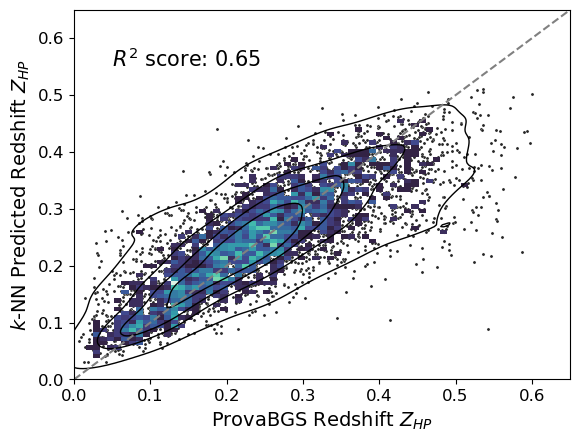

In [ ]:
# %% Redshift prediction from images

split = 5000
neigh = KNeighborsRegressor(weights="distance", n_neighbors=16)
neigh.fit(provabgs["image_embedding"][:-split], provabgs["Z_HP"][:-split])
preds = neigh.predict(provabgs["image_embedding"][-split:])
sns.scatterplot(x=provabgs["Z_HP"][-split:], y=preds, s=5, color=".15")
sns.histplot(
    x=np.clip(provabgs["Z_HP"][-split:], 0, 0.65),
    y=np.clip(preds, 0, 0.65),
    bins=64,
    pthresh=0.1,
    cmap="mako",
)
sns.kdeplot(
    x=provabgs["Z_HP"][-split:],
    y=preds,
    levels=5,
    color="black",
    linewidths=1,
)
plt.xlabel("ProvaBGS Redshift $Z_{HP}$", fontsize=14)
plt.ylabel(r"$k$-NN Predicted Redshift $Z_{HP}$", fontsize=14)
# plt.title("Redshift pred with image embeddings")
plt.plot([0, 0.65], [0, 0.65], color="grey", linestyle="--")
plt.xlim(0, 0.65)
plt.ylim(0, 0.65)
plt.text(
    0.05,
    0.55,
    "$R^2$ score: %0.2f" % (r2_score(provabgs["Z_HP"][-split:], preds)),
    fontsize=15,
)

plt.tick_params(axis="both", which="major", labelsize=12)

# plt.savefig("figures/zeroshot_redshift_image.png", bbox_inches="tight", dpi=400)
plt.show()

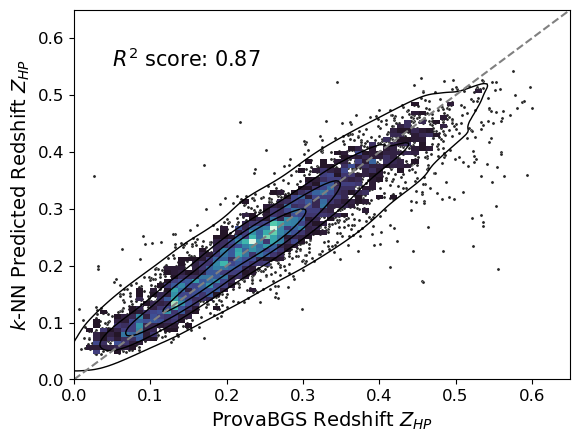

In [ ]:
# %% Redshift prediction from spectra

split = 5000
neigh = KNeighborsRegressor(weights="distance", n_neighbors=16)
neigh.fit(provabgs["spectrum_embedding"][:-split], provabgs["Z_HP"][:-split])
preds = neigh.predict(provabgs["spectrum_embedding"][-split:])
sns.scatterplot(x=provabgs["Z_HP"][-split:], y=preds, s=5, color=".15")
sns.histplot(
    x=np.clip(provabgs["Z_HP"][-split:], 0, 0.65),
    y=np.clip(preds, 0, 0.65),
    bins=64,
    pthresh=0.1,
    cmap="mako",
)
sns.kdeplot(
    x=provabgs["Z_HP"][-split:],
    y=preds,
    levels=5,
    color="black",
    linewidths=1,
)
plt.xlabel("ProvaBGS Redshift $Z_{HP}$", fontsize=14)
plt.ylabel(r"$k$-NN Predicted Redshift $Z_{HP}$", fontsize=14)
# plt.title("Redshift pred with spectrum embeddings")
plt.plot([0, 0.65], [0, 0.65], color="grey", linestyle="--")
plt.xlim(0, 0.65)
plt.ylim(0, 0.65)

plt.text(
    0.05,
    0.55,
    "$R^2$ score: %0.2f" % (r2_score(provabgs["Z_HP"][-split:], preds)),
    fontsize=15,
)
plt.tick_params(axis="both", which="major", labelsize=12)
# plt.savefig("figures/zeroshot_redshift_spectrum.png", bbox_inches="tight", dpi=400)
plt.show()

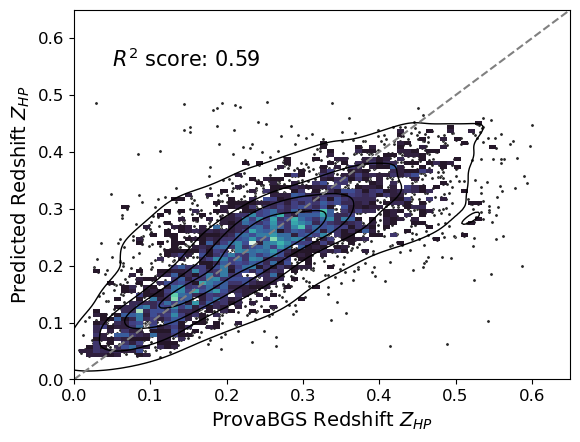

In [ ]:
# %% Cross-modal redshift prediction

split = 5000
neigh = KNeighborsRegressor(weights="distance", n_neighbors=16)
neigh.fit(provabgs["spectrum_embedding"][:-split], provabgs["Z_HP"][:-split])
preds = neigh.predict(provabgs["image_embedding"][-split:])
sns.scatterplot(x=provabgs["Z_HP"][-split:], y=preds, s=5, color=".15")
sns.histplot(
    x=np.clip(provabgs["Z_HP"][-split:], 0, 0.65),
    y=np.clip(preds, 0, 0.65),
    bins=64,
    pthresh=0.1,
    cmap="mako",
)
sns.kdeplot(
    x=provabgs["Z_HP"][-split:],
    y=preds,
    levels=5,
    color="black",
    linewidths=1,
)
plt.xlabel("ProvaBGS Redshift $Z_{HP}$", fontsize=14)
plt.ylabel("Predicted Redshift $Z_{HP}$", fontsize=14)
# plt.title("Redshift pred cross-modal (spectrum regression, prediction with image)")
plt.plot([0, 0.65], [0, 0.65], color="grey", linestyle="--")
plt.xlim(0, 0.65)
plt.ylim(0, 0.65)

plt.text(
    0.05,
    0.55,
    "$R^2$ score: %0.2f" % (r2_score(provabgs["Z_HP"][-split:], preds)),
    fontsize=15,
)
plt.tick_params(axis="both", which="major", labelsize=12)
# plt.savefig("figures/zeroshot_redshift_crossmodal.png", bbox_inches="tight", dpi=400)
plt.show()